# Coursera IBM Data Science - Capstone Project: Location Value Calculation for Pharmacies in the City of Zurich


## This Notebook is for Marketing Leaders and Investors of the Pharmacy Business.

### Introduction

Success for pharmacies depends much on their location. The location is the most important factor for the creation of revenue. 
Here I try to quantify the location value of pharmacies at the City of Zurich.
The location value for is among other factors determined by:
- The locations of competitors like other Pharmacies and stores that also sell Parfumes and Cosmetics.
- The locations of enablers like drugstores and cosmetic stores and luxury stores.
Foursquare can help analysing location datas for Zurich, because using it not only provides
Coordinates of locations, it also helps to visualize the situation on a map.
The report and the tool helps to analyze and to understand the current situation 
for Pharmacies in the City of Zurich. But is is also a useful for future 
developments. Where should I open a Pharmacy? Where should I close a Pharmacy.
Are there Marketing instruments to make situation better? Should we - as a chain - 
cooperate with competitor or even buy them? Should we sell stores of focus on
other products we sell beside drugs? And so on. One important basis for decision
makers are facts, we can identify with the help of Foursquare.

### Audience

This report is useful for the marketing leaders in Pharmacy chains, for risk 
managers and for all investors of the Pharmacy business. For leaders and decission
makers.

### Description of the used data

Foursquare let me help finding places and informations wich are hard to find manually. But with python, some libraries and the great visualizing tool folio I can present the results to everybody. Also I use request for Foursquare Pharmacies and other locations/stores that have an influence on the Pharmacy revenue. I selected
- Pharmacy
- Perfume Shop 
- Medical Supply Store 
- Doctor s Office 
- Health Beauty Service
- Drugstore 
- Cosmetics Shop

I say that all these locations have an impact on the revenue of a Pharmcy in the city. It would be interesting to talk to experts and identify more
criteria with impact on city pharmacies.



In [1]:
import folium
import json
import requests
import pandas as pd
import math
import matplotlib.pyplot as plt
import pyarrow.feather as feather # pip install pyarrow
import numpy as np
import copy
import time
import random
import sys 

In [2]:
# Function definitions

def fnc_distance(lat1,lng1,lat2,lng2):
    
    int_lat1 = lat1
    int_lng1 = lng1
    int_lat2 = lat2
    int_lng2 = lng2
    
    "distance in meters between two points. Input format is lat1,lng1,lat2,lng2"
        
    R           =6371000                    # radius of Earth in meters
    phi_1       =math.radians(int_lat1)
    phi_2       =math.radians(int_lat2)
    delta_phi   =math.radians(int_lat2-int_lat1)
    delta_lambda=math.radians(int_lng2-int_lng1)
    a           =math.sin(delta_phi/2.0)**2+math.cos(phi_1)*math.cos(phi_2)*math.sin(delta_lambda/2.0)**2
    c           =2*math.atan2(math.sqrt(a),math.sqrt(1-a))    
    return (R*c)

def fnc_force(dist,sign):
    
    int_distance = abs(dist) # meters
    int_sign     = sign      # +1 or -1
    
    "calculating the force, here in a linear model. Input is distance in meters, sign is 1 +1 or -1"
    
    int_reach    = 400 # shops further away than 400 meters have no (zero) influence on position    
    int_force    = (int_reach - int_distance ) / int_reach #  (700 minus dist)/700    
    if int_force <= 0:
        int_force =0
    return (int_force*int_sign)
    
def fnc_positionvalueof (lat, lng):    
    
    int_lat=lat
    int_lng=lng
    
    sum_force     = 0
    for indB in nearby_venues_dotcolor_fix.index:               # all colored objects here
        latB      = nearby_venues_dotcolor_fix['lat'][indB] 
        lngB      = nearby_venues_dotcolor_fix['lng'][indB]
        force     =  0
        sign      = +1
        if nearby_venues_dotcolor_fix['dotcolor'][indB] in ['yellow', 'red']:
            sign  = -1            
        distance  = fnc_distance(lat, lng, latB, lngB)
        force     = fnc_force(distance, sign)
        sum_force = sum_force + force
        
    return (sum_force)
    
def get_category_type(row):
    
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']

In [3]:
# Definitions:
min_lat    = 47.355   # Below, lower border
max_lat    = 47.385   # Top, upper border
min_lng    =  8.515   # Left border
max_lng    =  8.560   # Right border
stp_lat    =  0.0002  # 0.001 = 35 seconds, 0.0005 = 1 min, 15 seconds; 0.0003=3 Minutes;  0.0002=6 Minutes 20 Seconds

# Calculations: 
cnt_lat    = (min_lat + max_lat) /2 # Center Latutude = Average Latitude 
cnt_lng    = (min_lng + max_lng) /2 # Center Longitude= Average Longitude
dif_lat    = max_lat - min_lat      # diff lat 0.08800000000000097        0.0880
dif_lng    = max_lng - min_lng      # diff lng 0.0625                     0.0625
cal_radius = fnc_distance(cnt_lat,cnt_lng,min_lat,min_lng)  # in Meters
meters_wide= abs(int(round(fnc_distance(min_lat,0,max_lat,0),0)))  # in Meters
meters_high= abs(int(round(fnc_distance(0,min_lng,0,max_lng),0)))  # in Meters
meters_lat = abs(int(round(fnc_distance(cnt_lat,cnt_lng,cnt_lat+1,cnt_lng  ),0)))
meters_lng = abs(int(round(fnc_distance(cnt_lat,cnt_lng,cnt_lat  ,cnt_lng+1),0)))
latlng_prop= meters_lat/meters_lng  # 1.476536357359
stp_lng    =  stp_lat * latlng_prop                 # 0.001476536357359112
grid_lat   = fnc_distance (cnt_lat,cnt_lng, cnt_lat+stp_lat ,cnt_lng        ) # result in meters
grid_lng   = fnc_distance (cnt_lat,cnt_lng, cnt_lat         ,cnt_lng+stp_lng) # result in meters
grid_diff  = abs(grid_lat - grid_lng)


print('The Zurich Rectangle is', meters_wide, 'Meters wide and', meters_high,'Meters high.')
print('1 Latitude has a Length of             :', meters_lat,'Meters') 
print('1 Longitude has a Length of            :', meters_lng,'Meters') 
print('Latitude per Longitude Meter Proportion:', latlng_prop)
print('Grid in Meters Latitude                :', round(grid_lat,3))
print('Grid in Meters Longitude               :', round(grid_lng,3))
print('Grid Difference Lat Lng in Millimeters :', round(grid_diff*1000,3))
print('step stp_lat                           :', round(stp_lat,6)) 
print('Step stp_lng                           :', round(stp_lng,6))

The Zurich Rectangle is 3336 Meters wide and 5004 Meters high.
1 Latitude has a Length of             : 111195 Meters
1 Longitude has a Length of            : 75308 Meters
Latitude per Longitude Meter Proportion: 1.476536357359112
Grid in Meters Latitude                : 22.239
Grid in Meters Longitude               : 22.239
Grid Difference Lat Lng in Millimeters : 0.021
step stp_lat                           : 0.0002
Step stp_lng                           : 0.000295


Show a map of Zurich:

In [4]:
locationmap = folium.Map(location=[cnt_lat, cnt_lng], zoom_start=13) # a lower number shows more buildings
folium.CircleMarker([min_lat, max_lng], popup='<i>Corner</i>', tooltip='Corner Bottom Right').add_to(locationmap)
folium.CircleMarker([max_lat, max_lng], popup='<i>Corner</i>', tooltip='Corner Top Right'   ).add_to(locationmap)
folium.CircleMarker([min_lat, min_lng], popup='<i>Corner</i>', tooltip='Corner Bottom Left' ).add_to(locationmap)
folium.CircleMarker([max_lat, min_lng], popup='<i>Corner</i>', tooltip='Corner Top Left'    ).add_to(locationmap)
locationmap

In [5]:
CLIENT_ID = 'ZIVV2XBGULB4IKC2SFA33OT2WXMMAYEUNEMKP5NBZCSWL12U' # your Foursquare ID
CLIENT_SECRET = 'IAIN5OB2CYZ44STUMX0PDCKIMRTJ4OX3NUKEPA0O1U0XSY2M' # your Foursquare Secret
VERSION = '20190425' # Foursquare API version 20190425 20180605
print('Foursquare access is defined.')

Foursquare access is defined.


Foursquare has maybe 200 sort of locations defined. I select here the important ones for the project and I give them colors:
    - Red is for locations with a negative impact on Pharmacies
    - Yellow is for Pharmacies
    - Green is for locations with a positive impact on Pharmacies    - 

In [6]:
data = [
    ['4bf58dd8d48988d10f951735', 'Pharmacy'             ,'yellow'], 
    ['52f2ab2ebcbc57f1066b8b23', 'Perfume Shop'         ,'red'   ], 
    ['58daa1558bbb0b01f18ec206', 'Medical Supply Store' ,'red'   ], 
    ['4bf58dd8d48988d177941735', 'Doctor s Office'      ,'green' ], 
    ['54541900498ea6ccd0202697', 'Health Beauty Service','green' ], 
    ['5745c2e4498e11e7bccabdbd', 'Drugstore'            ,'green' ], 
    ['4bf58dd8d48988d10c951735', 'Cosmetics Shop'       ,'green' ],  
] 

# Create the pandas DataFrame 
df_stores = pd.DataFrame(data, columns = ['categoryId', 'categoryname', 'dotcolor'])
df_stores 

,categoryId,categoryname,dotcolor
0,4bf58dd8d48988d10f951735,Pharmacy,yellow
1,52f2ab2ebcbc57f1066b8b23,Perfume Shop,red
2,58daa1558bbb0b01f18ec206,Medical Supply Store,red
3,4bf58dd8d48988d177941735,Doctor s Office,green
4,54541900498ea6ccd0202697,Health Beauty Service,green
5,5745c2e4498e11e7bccabdbd,Drugstore,green
6,4bf58dd8d48988d10c951735,Cosmetics Shop,green


I build a string with all the interesting Foursquare Id's:

In [7]:
# Creating an empty Dataframe with column names only
venues_total = pd.DataFrame(columns=['name', 'address', 'city', 'categories', 'lat', 'lng'])


I build the URL and use the string from above.

In [8]:
LIMIT      = 999    # limit of number of venues returned by Foursquare API
radius     = abs(round(cal_radius + 2000,0)) # define radius
url        = "https://api.foursquare.com/v2/venues/explore?"
url = url + '&client_id='    + CLIENT_ID     
url = url + '&client_secret='+ CLIENT_SECRET 
url = url + '&v='            + VERSION       
url = url + '&ll='           + str(cnt_lat) +','+ str(cnt_lng)
url = url + '&radius='       + str(radius)
url = url + '&limit='        + str(LIMIT) 
# url = url + '&categoryId='   + categoryId

url   

for index, row in df_stores.iterrows():
    
    time.sleep((random.random()*1))
    url_send = url + '&categoryId='   + row['categoryId']
    dic_results = requests.get(url_send).json()  # This basically returns a Python dictionary
    #results.keys()                          # dict_keys(['meta', 'response'])       
        
    venues = dic_results['response']['groups'][0]['items']
    nearby_venues = pd.json_normalize(venues)
    # nearby_venues.head()

    # filter columns
    filtered_columns = ['venue.name', 'venue.location.address','venue.location.city', 'venue.categories', 'venue.location.lat', 'venue.location.lng']
    nearby_venues =nearby_venues.loc[:, filtered_columns]

    # filter the category for each row
    nearby_venues['venue.categories'] = nearby_venues.apply(get_category_type, axis=1)

    # clean columns
    nearby_venues.columns = [col.split(".")[-1] for col in nearby_venues.columns]
    
    print(len(nearby_venues['name'])) # must be smaller than 50
    
    # venues_total = venues_total + nearby_venues
    venues_total = venues_total.append(nearby_venues, ignore_index=True)    

22
7
8
19
36
4
40


In [9]:
# nearby_venues.head(100)
venues_total.head(300)

,name,address,city,categories,lat,lng
0,Bahnhof Apotheke,Bahnhofplatz 15,Zürich,Pharmacy,47.377142,8.539919
1,Bellevue Apotheke,Theaterstrasse 14,Zürich,Pharmacy,47.366755,8.545925
2,Victoria Apotheke,Bahnhofstr. 71,Zürich,Pharmacy,47.374796,8.538618
3,Rosen Apotheke,Niederdorfstrasse 11,Zürich,Pharmacy,47.373329,8.543857
4,Sun Store Apotheke,Löwenstrasse 31-35,Zürich,Pharmacy,47.375423,8.536251
...,...,...,...,...,...,...
131,qosms Body & Soul Spa,Röschibachstrasse 71,Zürich,Health & Beauty Service,47.393456,8.528175
132,exurbe cosmetics,Zollikerstrasse 249,Zürich,Cosmetics Shop,47.347696,8.566541
133,SEPHORA ZURICH LETZI,Baslerstrasse 50,Zürich,Perfume Shop,47.386464,8.499441
134,Health Beauty Lifestyle AG,Schaffhauserstrasse 276,Zürich,Cosmetics Shop,47.404640,8.548776


Do not read this. I just try to understand the JSON Data structure.

referralId                                            e-0-4b8ff66ef964a520926c33e3-0
reasons.count                                                                      0
reasons.items                      [{'summary': 'This spot is popular', 'type': '...
venue.id                                                    4b8ff66ef964a520926c33e3
venue.name                                                          Bahnhof Apotheke
venue.location.address                                               Bahnhofplatz 15
venue.location.lat                                                           47.3771
venue.location.lng                                                           8.53992
venue.location.labeledLatLngs      [{'label': 'display', 'lat': 47.37714158545192...
venue.location.distance                                                          278
venue.location.postalCode                                                       8001
venue.location.cc                                                                 CH
venue.location.city                                                           Zürich
venue.location.state                                                          Zürich
venue.location.country                                                       Schweiz
venue.location.formattedAddress              [Bahnhofplatz 15, 8001 Zürich, Schweiz]
venue.categories                   [{'id': '4bf58dd8d48988d10f951735', 'name': 'P...
venue.photos.count                                                                 0
venue.photos.groups                                                               []
venue.venuePage.id                                                               NaN
venue.location.crossStreet                                                       NaN
Name: 0, dtype: object
Bahnhof Apotheke [{'id': '4bf58dd8d48988d10f951735', 'name': 'Pharmacy', 'pluralName': 'Pharmacies', 'shortName': 'Pharmacy', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/pharmacy_', 'suffix': '.png'}, 'primary': True}]

I add the colors to the results.

In [10]:
List = [] 
for index, row in venues_total.iterrows():
    #print (row )
    #category = row["venue.categories"][0]['name']
    category  = row['categories']
    if "Pharmacy" in category:
        dotcolor ='yellow'
    elif 'Cosmetics Shop' in category:
        dotcolor ='red'
    elif 'Perfume Shop' in category:
        dotcolor ='red'    
    else:
        dotcolor ='green'
    #print (dotcolor,'\t' ,category)
    List.append(dotcolor) 
    #print ('Done')


Then I add the newly created List with colors (dotcolor) as Column to the Dataframe. 
Again:
- yellow for pharmacie
- green  for positive influence:
- red    for negative influence: Perfume Shop, Cosmetics Shop

In [11]:
print('number of items in list:'    , len(List))
print('number of rows in dataframe:', venues_total.shape[0]  )    

number of items in list: 136
number of rows in dataframe: 136


In [12]:
# Add column
nearby_venues_dotcolor = venues_total
nearby_venues_dotcolor['dotcolor'] = List

nearby_venues_dotcolor_fix = nearby_venues_dotcolor.apply(copy.deepcopy)

nearby_venues_dotcolor_fix

,name,address,city,categories,lat,lng,dotcolor
0,Bahnhof Apotheke,Bahnhofplatz 15,Zürich,Pharmacy,47.377142,8.539919,yellow
1,Bellevue Apotheke,Theaterstrasse 14,Zürich,Pharmacy,47.366755,8.545925,yellow
2,Victoria Apotheke,Bahnhofstr. 71,Zürich,Pharmacy,47.374796,8.538618,yellow
3,Rosen Apotheke,Niederdorfstrasse 11,Zürich,Pharmacy,47.373329,8.543857,yellow
4,Sun Store Apotheke,Löwenstrasse 31-35,Zürich,Pharmacy,47.375423,8.536251,yellow
...,...,...,...,...,...,...,...
131,qosms Body & Soul Spa,Röschibachstrasse 71,Zürich,Health & Beauty Service,47.393456,8.528175,green
132,exurbe cosmetics,Zollikerstrasse 249,Zürich,Cosmetics Shop,47.347696,8.566541,red
133,SEPHORA ZURICH LETZI,Baslerstrasse 50,Zürich,Perfume Shop,47.386464,8.499441,red
134,Health Beauty Lifestyle AG,Schaffhauserstrasse 276,Zürich,Cosmetics Shop,47.404640,8.548776,red


In [13]:
print('number of rows in dataframe nearby_venues_dotcolor including dublicates:', nearby_venues_dotcolor_fix.shape[0]  )
nearby_venues_dotcolor_fix.to_excel(r'nearby_venues_dotcolor1.xlsx', index = False)

nearby_venues_dotcolor_fix.drop_duplicates(keep='first',inplace=True)  # keep=’first’

print('number of rows in dataframe nearby_venues_dotcolor without dublicates:', nearby_venues_dotcolor_fix.shape[0]  )

nearby_venues_dotcolor_fix.to_excel(r'nearby_venues_dotcolor2.xlsx', index = False)


number of rows in dataframe nearby_venues_dotcolor including dublicates: 136
number of rows in dataframe nearby_venues_dotcolor without dublicates: 131


In [14]:
# save as file pyarrow needs numpy
# pip install pyarrow
import pyarrow.feather as feather
feather.write_feather(nearby_venues_dotcolor_fix, 'C:\\Users\\x\\Desktop\\projects\\Coursera_Capstone\\scripts\\nearby_venues_dotcolor_fix.fea')
# nearby_venues_dotcolor.to_csv("C:\\Users\\x\\Desktop\\projects\\Coursera_Capstone\\scripts\\nearby_venues.csv")


In [15]:
nearby_venues_dotcolor_fix

,name,address,city,categories,lat,lng,dotcolor
0,Bahnhof Apotheke,Bahnhofplatz 15,Zürich,Pharmacy,47.377142,8.539919,yellow
1,Bellevue Apotheke,Theaterstrasse 14,Zürich,Pharmacy,47.366755,8.545925,yellow
2,Victoria Apotheke,Bahnhofstr. 71,Zürich,Pharmacy,47.374796,8.538618,yellow
3,Rosen Apotheke,Niederdorfstrasse 11,Zürich,Pharmacy,47.373329,8.543857,yellow
4,Sun Store Apotheke,Löwenstrasse 31-35,Zürich,Pharmacy,47.375423,8.536251,yellow
...,...,...,...,...,...,...,...
129,J.brand cosmetics gmbh,Seefeldstrasse 204,Zürich,Cosmetics Shop,47.353518,8.558353,red
130,Swiss Dental Center,Heinrichstrasse 239,Zürich,Cosmetics Shop,47.389165,8.521518,red
132,exurbe cosmetics,Zollikerstrasse 249,Zürich,Cosmetics Shop,47.347696,8.566541,red
134,Health Beauty Lifestyle AG,Schaffhauserstrasse 276,Zürich,Cosmetics Shop,47.404640,8.548776,red


In [16]:
# .drop(['B', 'C'], axis=1)
for col in nearby_venues_dotcolor_fix.columns: 
    print(col) 
#nearby_venues_dotcolor.drop(columns=['venue.id', 'referralId', 'reasons.count'], axis=1)
# nearby_venues_dotcolor

name
address
city
categories
lat
lng
dotcolor


Here I create the Map of Zurich with the colored locations:

In [17]:
# for lat, lng, label in result['Latitude'], result['Longitude'], result['Neighbourhood']:
# label = folium.Popup(label, parse_html=True)
for ind in nearby_venues_dotcolor_fix.index: 
              
    popupname = nearby_venues_dotcolor_fix['categories'][ind] +' '+ nearby_venues_dotcolor_fix['name'][ind]
    
    folium.CircleMarker(
        [nearby_venues_dotcolor_fix['lat'][ind], nearby_venues_dotcolor_fix['lng'][ind]],
        radius=5,
        popup=popupname,
        color=nearby_venues_dotcolor_fix['dotcolor'][ind],
        fill=False,
        fill_color=nearby_venues_dotcolor_fix['dotcolor'][ind],
        fill_opacity=0,
        parse_html=False).add_to(locationmap)  

folium.CircleMarker([min_lat, max_lng], popup='<i>Corner</i>', tooltip='Corner Bottom Right').add_to(locationmap)
folium.CircleMarker([max_lat, max_lng], popup='<i>Corner</i>', tooltip='Corner Top Right'   ).add_to(locationmap)
folium.CircleMarker([min_lat, min_lng], popup='<i>Corner</i>', tooltip='Corner Bottom Left' ).add_to(locationmap)
folium.CircleMarker([max_lat, min_lng], popup='<i>Corner</i>', tooltip='Corner Top Left'    ).add_to(locationmap)

locationmap

Calculate the distance between two lon/lat coordnate pairs

For each pharmacy (yellow dot), we calculate distances to other points. We us Newtons Law to calculate the force out of the distance.
Here, force can be negative, eg. for close competitors or positive for enables like doctor offices.
For each pharmacy we calculate the sum of forces. 

In [18]:
list = []
for ind1 in nearby_venues_dotcolor_fix.index:    
    lat1     = nearby_venues_dotcolor_fix['lat'][ind1]
    lng1     = nearby_venues_dotcolor_fix['lng'][ind1]    
    sum_force=0
    
    for ind2 in nearby_venues_dotcolor_fix.index:        
        lat2 = nearby_venues_dotcolor_fix['lat'][ind2]
        lng2 = nearby_venues_dotcolor_fix['lng'][ind2]
        sign = 0
        
        ################################################
        if   nearby_venues_dotcolor_fix['dotcolor'][ind2] == 'red':
            sign = -1
        elif nearby_venues_dotcolor_fix['dotcolor'][ind2] == 'yellow':            # Other pharmacies are competitors
            sign = -1
        else:
            sign = +1
        ################################################
                      
        distance  = fnc_distance(lat1,lng1,lat2,lng2)
        force     = fnc_force(distance, sign)
        sum_force = sum_force + force

    list.append(sum_force)
    
nearby_venues_dotcolor_fix['force'] = list   
print ('Done')        
        

Done


Now we have an enhanced table with a force column.

In [19]:
nearby_venues_dotcolor_fix

,name,address,city,categories,lat,lng,dotcolor,force
0,Bahnhof Apotheke,Bahnhofplatz 15,Zürich,Pharmacy,47.377142,8.539919,yellow,-6.562144
1,Bellevue Apotheke,Theaterstrasse 14,Zürich,Pharmacy,47.366755,8.545925,yellow,-1.100178
2,Victoria Apotheke,Bahnhofstr. 71,Zürich,Pharmacy,47.374796,8.538618,yellow,-3.957979
3,Rosen Apotheke,Niederdorfstrasse 11,Zürich,Pharmacy,47.373329,8.543857,yellow,-1.180184
4,Sun Store Apotheke,Löwenstrasse 31-35,Zürich,Pharmacy,47.375423,8.536251,yellow,-3.864038
...,...,...,...,...,...,...,...,...
129,J.brand cosmetics gmbh,Seefeldstrasse 204,Zürich,Cosmetics Shop,47.353518,8.558353,red,-1.000000
130,Swiss Dental Center,Heinrichstrasse 239,Zürich,Cosmetics Shop,47.389165,8.521518,red,-1.388125
132,exurbe cosmetics,Zollikerstrasse 249,Zürich,Cosmetics Shop,47.347696,8.566541,red,-1.000000
134,Health Beauty Lifestyle AG,Schaffhauserstrasse 276,Zürich,Cosmetics Shop,47.404640,8.548776,red,-1.000000


In [20]:
# Copy Table
nearby_venues_sorted = nearby_venues_dotcolor_fix.apply(copy.deepcopy)

We are only intersted in the location value of pharmacies. We sort the pharmacies so that the pharmacies with the
best force are at the top.

In [21]:
# Eliminate red and green
indexNames = nearby_venues_sorted[ nearby_venues_sorted['dotcolor'] == 'red'   ].index
nearby_venues_sorted.drop(indexNames , inplace=True)

indexNames = nearby_venues_sorted[ nearby_venues_sorted['dotcolor'] == 'green' ].index
nearby_venues_sorted.drop(indexNames , inplace=True)
     

In [22]:
# Sort yellow (Rest)
nearby_venues_sorted = nearby_venues_sorted.sort_values(by ='force', ascending=False)

In [23]:
nearby_venues_sorted = nearby_venues_sorted.sort_values(by ='force', ascending=False)

nearby_venues_sorted   

,name,address,city,categories,lat,lng,dotcolor,force
17,TopPharm Apotheke & Drogerie Höschgasse,Höschgasse 50,Zürich,Pharmacy,47.357833,8.554642,yellow,1.400480
10,Dr. Andres Apotheke Stadelhofen,Goethestrasse 22,Zürich,Pharmacy,47.366116,8.548078,yellow,1.127280
8,Berg-Apotheke,NaN,Zürich,Pharmacy,47.373271,8.529176,yellow,0.318340
13,Anrig Drogerie Naturathek,Forchstrasse 26,Zürich,Pharmacy,47.363991,8.556103,yellow,-0.135609
9,Topwell Apotheke-Drogerie,Tessinerplatz 10,Zürich,Pharmacy,47.364583,8.531195,yellow,-0.301005
19,Apotheke Schaffhauserplatz,Seminarstrasse 1,Zürich,Pharmacy,47.391778,8.538677,yellow,-0.309384
20,Vision hair,Nordstrasse 89,Zürich,Pharmacy,47.388483,8.535689,yellow,-0.790753
12,DROPA Apotheke & Post Hottingen,"Freiestrasse 55, Beim Hottingerplatz",Zürich,Pharmacy,47.369764,8.555808,yellow,-1.000000
94,Drogama Apotheke Drogerie,NaN,Zürich,Pharmacy,47.370014,8.508480,yellow,-1.000000
21,Wehntal Apotheke,NaN,NaN,Pharmacy,47.403184,8.536066,yellow,-1.000000


1 	 TopPharm Apotheke & Drogerie Höschgasse
2 	 Dr. Andres Apotheke Stadelhofen
3 	 Berg-Apotheke
4 	 Anrig Drogerie Naturathek
5 	 Topwell Apotheke-Drogerie
6 	 Apotheke Schaffhauserplatz
7 	 Vision hair
8 	 DROPA Apotheke & Post Hottingen
9 	 Drogama Apotheke Drogerie
10 	 Wehntal Apotheke
11 	 Bären-Apotheke
12 	 Neumarkt Apotheke Drogerie
13 	 Bellevue Apotheke
14 	 TopPharm Leonhards-Apotheke
15 	 Rosen Apotheke
16 	 Coop Vitality
17 	 apodoc
18 	 Odeon Apotheke
19 	 DROPA Drogerie Apotheke Limmatplatz
20 	 TopPharm Limmatplatz Apotheke
21 	 Sun Store Apotheke
22 	 Victoria Apotheke
23 	 Bahnhof Apotheke
24 	 Coop Vitality Zürich Bahnhofstrasse
25 	 Amavita Apotheke


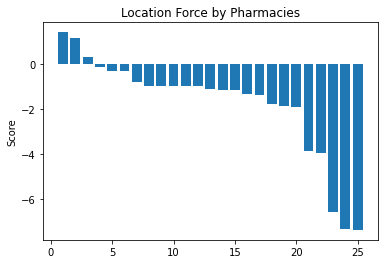

In [24]:
# Replace NaN by ''
nearby_venues_sorted.address = nearby_venues_sorted.address.fillna('NA')  # https://forums.wikitechy.com/question/pandas-replace-nan-with-blank-empty-string/

labels = nearby_venues_sorted['name'] .tolist() # Labels must be unique for creating a bar chart !
force  = nearby_venues_sorted['force'].tolist()

temp =0
for i in labels:
    print (temp+1,'\t', i)
    labels[temp] = temp+1 #    i[:2];    
    #labels[temp] = i[:10] #    i[:2];    
    #print (temp+1,'\t', labels[temp], '\t', i)
    temp = temp + 1

# draw barchart    
width   = 0.8
fig, ax = plt.subplots()
ax.bar(labels, force, width )
ax.set_ylabel('Score')
ax.set_title('Location Force by Pharmacies')
plt.show()

In [25]:
print('The following calculation may take 6 Minutes, 30 Seconds')

The following calculation may take 6 Minutes, 30 Seconds


In [26]:
data_length               = 0
data_high                 = 0
folium_tooltip            = 'Click me!'
filename_excel_dfr_matrix = 'dfr_matrix.xlsx'

##########################################
dic_matrix = {'data_high':[], 'data_length':[], 'lat':[], 'lng':[], 'myforce':[], 'googlemaps':[] }
dfr_matrix = pd.DataFrame(dic_matrix)
##########################################

m = folium.Map(
    location  =[cnt_lat, cnt_lng], 
    zoom_start=12,
)

lng = min_lng
while lng <= max_lng:
       
    lat       = min_lat
    data_high = 0 
    while lat <= max_lat:
        
        myforce       = fnc_positionvalueof(lat,lng)
        if myforce <-2:
            myforce =-2
        ############################################################
        matrix_googlemaps = str(lat) + ', ' + str(lng) # 47.367296, 8.544618 Google Format: Latitude, Longitude
        matrix_new_row = {
                   'data_high'         :data_high      , 
                   'data_length'       :data_length    , 
                   'lat'               :round(lat,4)   , 
                   'lng'               :round(lng,4)   , 
                   'myforce'           :myforce        , 
                   'googlemaps'        :matrix_googlemaps  }
        dfr_matrix = dfr_matrix.append(matrix_new_row, ignore_index=True)
        ############################################################
        
        folium.CircleMarker([lat, lng], popup='<i>I am here</i>', tooltip=folium_tooltip).add_to(m)                
        lat         = lat+stp_lat
        data_high   = data_high + 1  
        
    lng         = lng+stp_lng
    data_length = data_length + 1
dfr_matrix.to_excel(r'dfr_matrix.xlsx', index = False)    

#folium.Marker([max_lat, min_lng], popup='<i>Corner</i>', tooltip='Top Left'    ).add_to(m)
#folium.Marker([max_lat, max_lng], popup='<i>Corner</i>', tooltip='Top Right'   ).add_to(m)
#folium.Marker([min_lat, min_lng], popup='<i>Corner</i>', tooltip='Bottom Left' ).add_to(m) 
#folium.Marker([min_lat, max_lng], popup='<i>Corner</i>', tooltip='Bottom Right').add_to(m)

m


In [27]:
# create array, matrix for uniform data. Zero is top left.

filename_excel_dfr_matrix = 'dfr_matrix.xlsx'
df                        = pd.read_excel(filename_excel_dfr_matrix )
high                      = df['data_high'  ].max()
length                    = df['data_length'].max()
df2                       = df.pivot(index='lat', columns='lng',values='myforce')

df2.sort_index(ascending=False, inplace=True)

uniform_data = df2

df2

lng,8.5150,8.5153,8.5156,8.5159,8.5162,8.5165,8.5168,8.5171,8.5174,8.5177,...,8.5572,8.5575,8.5578,8.5581,8.5584,8.5587,8.5590,8.5593,8.5596,8.5599
lat,,,,,,,,,,,,,,,,,,,,,
47.3850,0.0,0.0,-0.003501,-0.040363,-0.075352,-0.108248,-0.138809,-0.166780,-0.191891,-0.213869,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
47.3848,0.0,0.0,0.000000,0.000000,-0.030759,-0.062089,-0.091097,-0.117555,-0.141225,-0.161873,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
47.3846,0.0,0.0,0.000000,0.000000,0.000000,-0.014955,-0.042534,-0.067613,-0.089983,-0.109443,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
47.3844,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,-0.017063,-0.038258,-0.056649,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
47.3842,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.003551,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
47.3558,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.018967,-0.042989,...,0.128918,0.018310,-0.089837,-0.194977,-0.246025,-0.290189,-0.303151,-0.333017,-0.324146,-0.302992
47.3556,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.019210,-0.089595,-0.195838,-0.285788,-0.332282,-0.367361,-0.387174,-0.394623,-0.376031,-0.353178
47.3554,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,-0.095065,-0.202279,-0.306755,-0.375768,-0.420795,-0.444385,-0.462830,-0.447531,-0.427219,-0.402404


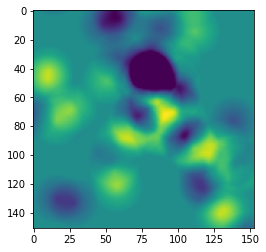

In [28]:
# https://www.techtrekking.com/heatmap-using-matplotlib-and-seaborn-data-visualization-using-python/
from matplotlib import pyplot as plt
import numpy as np

plt.imshow(uniform_data)
plt.savefig('heatmap-01.png')
plt.show()

In [29]:
import seaborn as sns
#import numpy as np
plt.rcParams['figure.figsize'] = (20.0, 10.0)
plt.rcParams['font.family'] = "serif"

df2.head()

lng,8.5150,8.5153,8.5156,8.5159,8.5162,8.5165,8.5168,8.5171,8.5174,8.5177,...,8.5572,8.5575,8.5578,8.5581,8.5584,8.5587,8.5590,8.5593,8.5596,8.5599
lat,,,,,,,,,,,,,,,,,,,,,
47.3850,0.0,0.0,-0.003501,-0.040363,-0.075352,-0.108248,-0.138809,-0.166780,-0.191891,-0.213869,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
47.3848,0.0,0.0,0.000000,0.000000,-0.030759,-0.062089,-0.091097,-0.117555,-0.141225,-0.161873,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
47.3846,0.0,0.0,0.000000,0.000000,0.000000,-0.014955,-0.042534,-0.067613,-0.089983,-0.109443,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
47.3844,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,-0.017063,-0.038258,-0.056649,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
47.3842,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.003551,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Text(502.0000000000001, 0.5, 'Latitude')

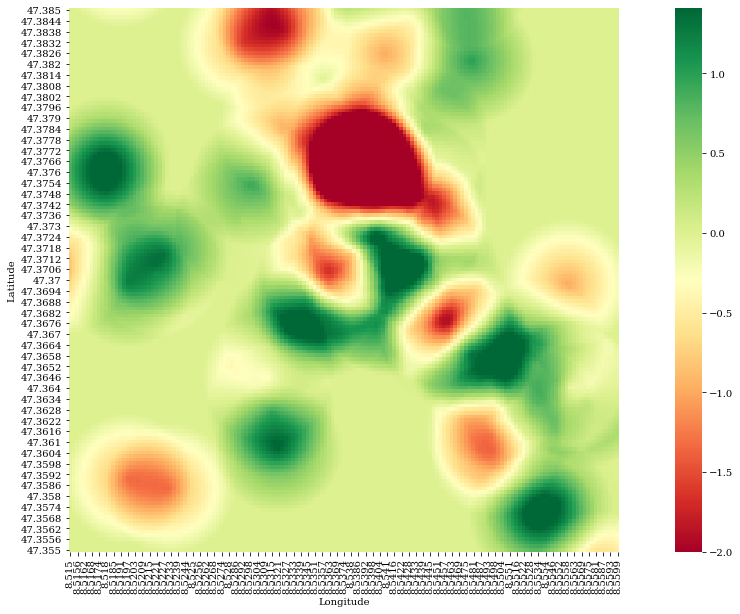

In [30]:
sns.heatmap(df2, 
            robust=True,
            square=True,
            cmap  ='RdYlGn',             
)
plt.xlabel('Longitude')
plt.ylabel('Latitude' )

Text(502.0000000000001, 0.5, 'Latitude')

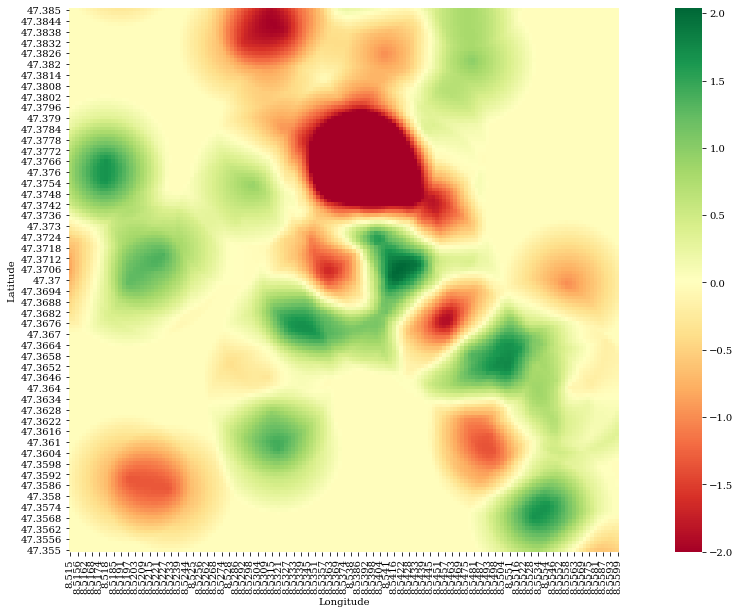

In [31]:
sns.heatmap(df2, 
            cmap='RdYlGn', 
            square=True
           )
plt.xlabel('Longitude')
plt.ylabel('Latitude' )

Text(5, 12.3, 'Heat Map for opening new Pharmacies at Zurich')

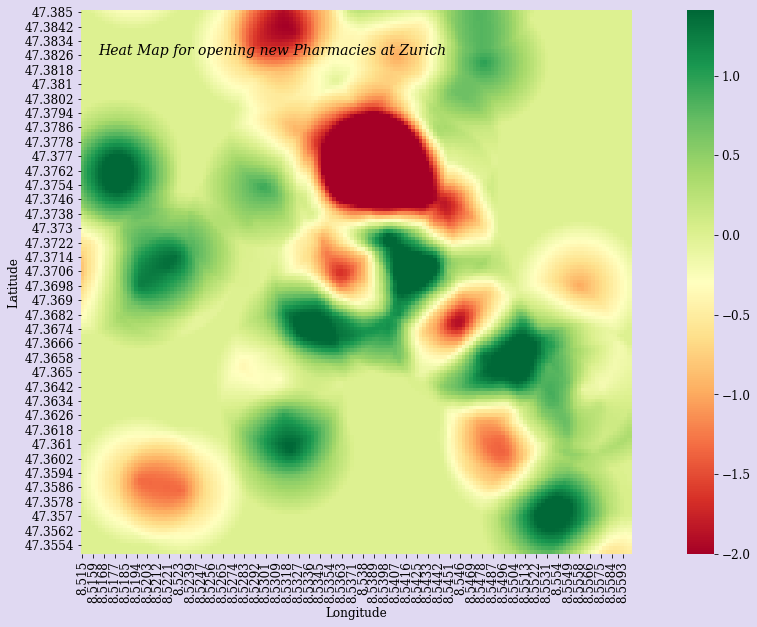

In [32]:
# Finalize
plt.rcParams['font.size'] = 12
bg_color = (0.88,0.85,0.95)
plt.rcParams['figure.facecolor'] = bg_color
plt.rcParams['axes.facecolor']   = bg_color
fig, ax = plt.subplots(1)
p = sns.heatmap(df2,
                robust=True,
                cmap='RdYlGn',
                annot=False,
                fmt=".1f",
                annot_kws={'size':12},
                square=True,
                ax=ax)
plt.xlabel('Longitude')
plt.ylabel('Latitude')
#ax.set_ylim((0,15))
plt.text(5,12.3, "Heat Map for opening new Pharmacies at Zurich", fontsize = 14, color='Black', fontstyle='italic')

In [33]:
p.get_figure().savefig('Finalheatmap.png')